<a href="https://colab.research.google.com/github/Anokyeken/Anokye-/blob/Detect-violence-and-non-violence/extramus.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#%pip install tensorflow
#%pip install keras
#pip install --upgrade tensorflow
#%pip install keras
#%pip install imutils
#%pip install numpy
#%pip install -c intel mkl
#%pip install keras-resnet
#%pip install --upgrade opencv-python
#%pip install --upgrade pip
#%pip install moviepy scikit-image



In [ ]:
import shutil
import math
import random
import numpy as np
import datetime as dt
import tensorflow as tf
import keras
from collections import deque
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import cv2
import os
import glob
from sklearn.metrics import confusion_matrix
from keras.layers import *
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model
from keras.applications.mobilenet_v2 import MobileNetV2
from sklearn.metrics import classification_report

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#%pip uninstall opencv-python -y


In [ ]:
#%pip install opencv-contrib-python

In [ ]:


non_violence_dir = "/content/drive/MyDrive/Real Life Violence Dataset/NonViolence"
violence_dir = "/content/drive/MyDrive/Real Life Violence Dataset/Violence"

non_violence_files = glob.glob(os.path.join(non_violence_dir, '*.mp4'))
violence_files = glob.glob(os.path.join(violence_dir, '*.mp4'))

print(f"Found {len(non_violence_files)} non-violence files")
print(f"Found {len(violence_files)} violence files")

Found 913 non-violence files
Found 315 violence files


In [ ]:


non_violence_path = '/content/drive/MyDrive/Real Life Violence Dataset/NonViolence'
violence_path = '/content/drive/MyDrive/Real Life Violence Dataset/Violence'

non_violence_videos = os.listdir(non_violence_path)
violence_videos = os.listdir(violence_path)

print(f'Non-violence videos: {len(non_violence_videos)}')
print(f'Violence videos: {len(violence_videos)}')

non_violence_video = cv2.VideoCapture(os.path.join(non_violence_path, non_violence_videos[0]))
violence_video = cv2.VideoCapture(os.path.join(violence_path, violence_videos[0]))

non_violence_length = int(non_violence_video.get(cv2.CAP_PROP_FRAME_COUNT))
non_violence_fps = non_violence_video.get(cv2.CAP_PROP_FPS)
violence_length = int(violence_video.get(cv2.CAP_PROP_FRAME_COUNT))
violence_fps = violence_video.get(cv2.CAP_PROP_FPS)

print(f'Non-violence video: {non_violence_length} frames at {non_violence_fps} fps')
print(f'Violence video: {violence_length} frames at {violence_fps} fps')


Non-violence videos: 961
Violence videos: 314
Non-violence video: 150 frames at 30.0 fps
Violence video: 103 frames at 15.416153255350068 fps


In [ ]:
def process_video(video_path, size=(224, 224)):
    # Open the video file
    video = cv2.VideoCapture(video_path)

    ret, frame = video.read()

    frames = []

    while ret:
        frame_resized = cv2.resize(frame, size)

        frame_normalized = frame_resized / 255.0

        frames.append(frame_normalized)

        ret, frame = video.read()

    return frames

video_path = os.path.join(non_violence_path, non_violence_videos[3])

frames = process_video(video_path)

print(f'Number of frames: {len(frames)}')
print(f'Shape of first frame: {frames[3].shape}')




Number of frames: 125
Shape of first frame: (224, 224, 3)


In [ ]:
from IPython.display import HTML
from base64 import b64encode

# To Show a Video in Notebook
def Play_Video(filepath):
    html = ''
    video = open(filepath,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=640 muted controls autoplay loop><source src="%s" type="video/mp4"></video>' % src
    return HTML(html)

In [ ]:
NonViolence_files = os.listdir(non_violence_path)
Violence_files = os.listdir(violence_path)

In [ ]:
Rand_NonViolence_Video = random.choice(NonViolence_files)
Rand_Violence_Video = random.choice(Violence_files)

NameError: ignored

In [ ]:
Play_Video(f"{non_violence_path}/{Rand_NonViolence_Video}")

In [ ]:
Play_Video(f"{violence_path}/{Rand_Violence_Video}")

In [ ]:
IMAGE_HEIGHT , IMAGE_WIDTH = 44, 44
SEQUENCE_LENGTH = 8


DATASET_DIR = "../content/drive/MyDrive/Real Life Violence Dataset/"

CLASSES_LIST = ["NonViolence","Violence"]

In [ ]:
def frames_extraction(video_path):

    frames_list = []

    # Read the Video File
    video_reader = cv2.VideoCapture(video_path)

    # Get the total number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))

    # Calculate the the interval after which frames will be added to the list.
    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH), 1)
    # Iterate through the Video Frames.
    for frame_counter in range(SEQUENCE_LENGTH):

        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)

        # Reading the frame from the video.
        success, frame = video_reader.read()

        if not success:
            break

        # Resize the Frame to fixed height and width.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))

        # Normalize the resized frame
        normalized_frame = resized_frame / 255

    # Append the normalized frame into the frames list
        frames_list.append(normalized_frame)


    video_reader.release()

    return frames_list

In [ ]:
def create_dataset():

    features = []
    labels = []
    video_files_paths = []

    # Iterating through all the classes.
    for class_index, class_name in enumerate(CLASSES_LIST):

        print(f'Extracting Data of Class: {class_name}')

        # Get the list of video files present in the specific class name directory.
        files_list = os.listdir(os.path.join(DATASET_DIR, class_name))

        # Iterate through all the files present in the files list.
        for file_name in files_list:

            # Get the complete video path.
            video_file_path = os.path.join(DATASET_DIR, class_name, file_name)

            # Extract the frames of the video file.
            frames = frames_extraction(video_file_path)

            # Check if the extracted frames are equal to the SEQUENCE_LENGTH specified.
            # So ignore the vides having frames less than the SEQUENCE_LENGTH.
            if len(frames) == SEQUENCE_LENGTH:

                # Append the data to their repective lists.
                features.append(frames)
                labels.append(class_index)
                video_files_paths.append(video_file_path)

    features = np.asarray(features)
    labels = np.array(labels)
    return features, labels, video_files_paths



In [ ]:
features, labels, video_files_paths = create_dataset()

Extracting Data of Class: NonViolence
Extracting Data of Class: Violence


In [ ]:
# Saving the extracted data
np.save("features.npy",features)
np.save("labels.npy",labels)
np.save("video_files_paths.npy",video_files_paths)


In [ ]:
features, labels, video_files_paths = np.load("features.npy") , np.load("labels.npy") ,  np.load("video_files_paths.npy")

In [ ]:
one_hot_encoded_labels = to_categorical(labels)

In [ ]:
# Split the dataset into training and testing .

features_train, features_test, labels_train, labels_test = train_test_split(features, one_hot_encoded_labels, test_size = 0.2,
                                                                            shuffle = True, random_state = 42)



In [ ]:
print(features_train.shape,labels_train.shape )
print(features_test.shape, labels_test.shape)

(1020, 8, 44, 44, 3) (1020, 2)
(255, 8, 44, 44, 3) (255, 2)


In [ ]:


mobilenet = MobileNetV2(include_top=False , weights="imagenet")

#Fine-Tuning to make the last 40 layer trainable
mobilenet.trainable=True

for layer in mobilenet.layers[:-40]:
  layer.trainable=False

mobilenet.summary()

9406464/9406464 [==============================] - 0s 0us/step
Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 Conv1 (Conv2D)                 (None, None, None,   864         ['input_1[0][0]']                
                                32)                                                               
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, None, None,   128         ['Conv1[0][0]']                  
                

## create the model

In [ ]:
def create_model():

    model = Sequential()


    #Specifying Input to match features shape
    model.add(Input(shape = (SEQUENCE_LENGTH, IMAGE_HEIGHT, IMAGE_WIDTH, 3)))

    # Passing mobilenet in the TimeDistributed layer to handle the sequence
    model.add(TimeDistributed(mobilenet))

    model.add(Dropout(0.25))
    model.add(TimeDistributed(Flatten()))
    # Long short-term memory model
    lstm_fw = LSTM(units=32)
    lstm_bw = LSTM(units=32, go_backwards = True)

    model.add(Bidirectional(lstm_fw, backward_layer = lstm_bw))

    model.add(Dropout(0.25))

    model.add(Dense(256,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(128,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(64,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(32,activation='relu'))
    model.add(Dropout(0.25))


    model.add(Dense(len(CLASSES_LIST), activation = 'softmax'))


    model.summary()

    return model



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDistr  (None, 8, 1, 1, 1280)    2257984   
 ibuted)                                                         
                                                                 
 dropout (Dropout)           (None, 8, 1, 1, 1280)     0         
                                                                 
 time_distributed_1 (TimeDis  (None, 8, 1280)          0         
 tributed)                                                       
                                                                 
 bidirectional (Bidirectiona  (None, 64)               336128    
 l)                                                              
                                                                 
 dropout_1 (Dropout)         (None, 64)                0         
                                                        

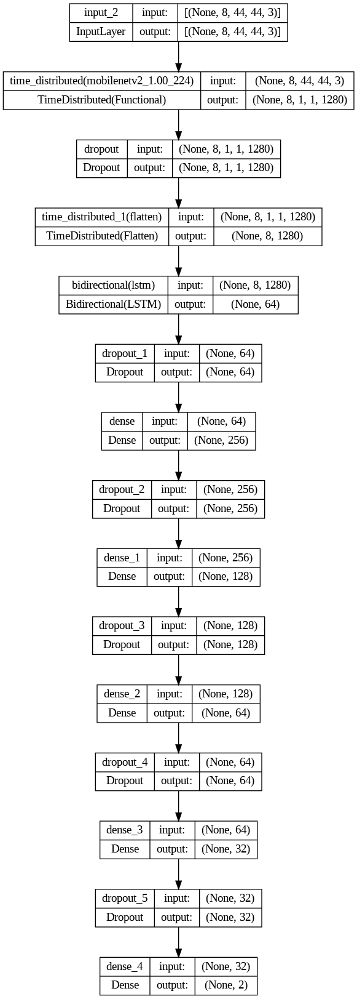

In [ ]:
MoBiLSTM_model = create_model()

# Plot the structure of the contructed LRCN model.
plot_model(MoBiLSTM_model, to_file = 'MobBiLSTM_model_structure_plot.png', show_shapes = True, show_layer_names = True)

In [ ]:
early_stopping_callback = EarlyStopping(monitor = 'val_accuracy', patience = 10, restore_best_weights = True)

# Create ReduceLROnPlateau Callback to reduce overfitting by decreasing learning
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss',
                                                  factor=0.6,
                                                  patience=5,
                                                  min_lr=0.00005,
                                                  verbose=1)

# Compiling the model
MoBiLSTM_model.compile(loss = 'categorical_crossentropy', optimizer = 'sgd', metrics = ["accuracy"])
# Fitting the model
MobBiLSTM_model_history = MoBiLSTM_model.fit(x = features_train, y = labels_train, epochs = 20, batch_size = 8 ,
                                             shuffle = True, validation_split = 0.2, callbacks = [early_stopping_callback,reduce_lr])

Epoch 1/20
102/102 [==============================] - 35s 274ms/step - loss: 0.6034 - accuracy: 0.7328 - val_loss: 0.6080 - val_accuracy: 0.7353 - lr: 0.0100
Epoch 2/20
102/102 [==============================] - 26s 254ms/step - loss: 0.5792 - accuracy: 0.7475 - val_loss: 0.5842 - val_accuracy: 0.7353 - lr: 0.0100
Epoch 3/20
102/102 [==============================] - 26s 253ms/step - loss: 0.5714 - accuracy: 0.7488 - val_loss: 0.5711 - val_accuracy: 0.7353 - lr: 0.0100
Epoch 4/20
102/102 [==============================] - 26s 252ms/step - loss: 0.5549 - accuracy: 0.7488 - val_loss: 0.5732 - val_accuracy: 0.7353 - lr: 0.0100
Epoch 5/20
102/102 [==============================] - 26s 253ms/step - loss: 0.5427 - accuracy: 0.7488 - val_loss: 0.5702 - val_accuracy: 0.7353 - lr: 0.0100
Epoch 6/20
102/102 [==============================] - 26s 253ms/step - loss: 0.5284 - accuracy: 0.7488 - val_loss: 0.5765 - val_accuracy: 0.7353 - lr: 0.0100
Epoch 7/20
102/102 [==============================] 

In [ ]:
def plot_metric(model_training, met_name_1, met_name_2, plot_name):

    met_value_1 = model_training.history[met_name_1]
    met_value_2 = model_training.history[met_name_2]

    # Get the Epochs Count
    epochs = range(len(met_value_1))

    plt.plot(epochs, met_value_1, 'blue', label = met_name_1)
    plt.plot(epochs, met_value_2, 'orange', label = met_name_2)

    plt.title(str(plot_name))

    plt.legend()

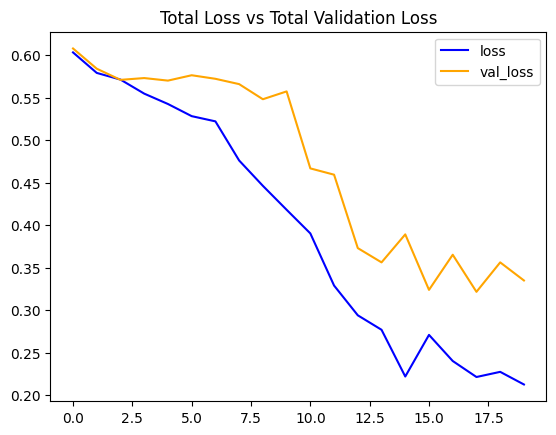

In [ ]:
plot_metric(MobBiLSTM_model_history, 'loss', 'val_loss', 'Total Loss vs Total Validation Loss')

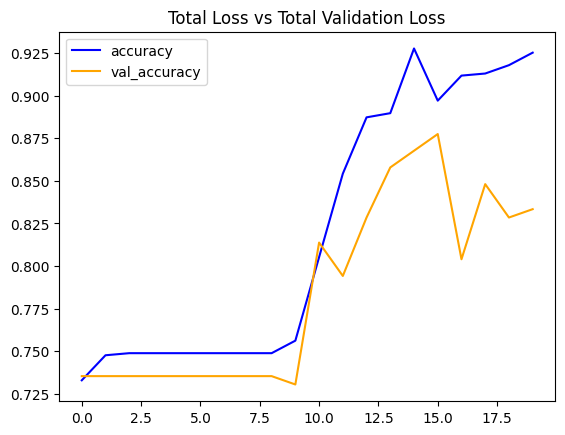

In [ ]:
plot_metric(MobBiLSTM_model_history, 'accuracy', 'val_accuracy', 'Total Loss vs Total Validation Loss')

In [ ]:
labels_predict = MoBiLSTM_model.predict(features_test)

8/8 [==============================] - 3s 186ms/step


In [ ]:
labels_predict = np.argmax(labels_predict , axis=1)
labels_test_normal = np.argmax(labels_test , axis=1)
labels_test_normal.shape , labels_predict.shape

((255,), (255,))

## predict the accuracy

In [ ]:

AccScore = accuracy_score(labels_predict, labels_test_normal)
print('Accuracy Score is : ', AccScore)

Accuracy Score is :  0.8274509803921568


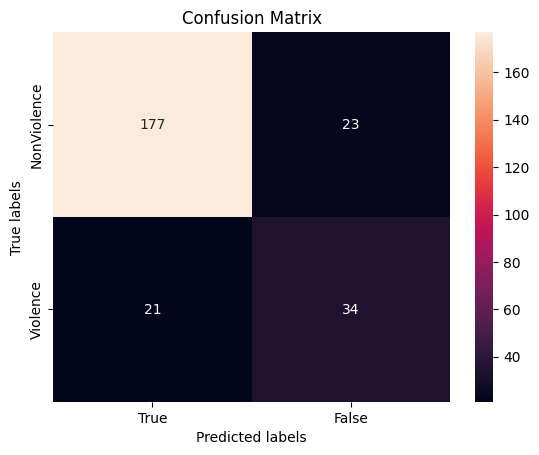

In [ ]:
ax= plt.subplot()
cm=confusion_matrix(labels_test_normal, labels_predict)
sns.heatmap(cm, annot=True, fmt='g', ax=ax);

ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.set_title('Confusion Matrix');
ax.xaxis.set_ticklabels(['True', 'False']); ax.yaxis.set_ticklabels(['NonViolence', 'Violence']);

In [ ]:
ClassificationReport = classification_report(labels_test_normal,labels_predict)
print('Classification Report is : \n', ClassificationReport)

Classification Report is : 
               precision    recall  f1-score   support

           0       0.89      0.89      0.89       200
           1       0.60      0.62      0.61        55

    accuracy                           0.83       255
   macro avg       0.75      0.75      0.75       255
weighted avg       0.83      0.83      0.83       255



In [ ]:
def predict_frames(video_file_path, output_file_path, SEQUENCE_LENGTH):

    # Read from the video file.
    video_reader = cv2.VideoCapture(video_file_path)

    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # VideoWriter to store the output video in the disk.
    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('m', 'p', '4', 'v'),
                                    video_reader.get(cv2.CAP_PROP_FPS), (original_video_width, original_video_height))
    # Declare a queue to store video frames.
    frames_queue = deque(maxlen = SEQUENCE_LENGTH)

    # Store the predicted class in the video.
    predicted_class_name = ''

    # Iterate until the video is accessed successfully.
    while video_reader.isOpened():

        ok, frame = video_reader.read()

        if not ok:
            break

        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))

        # Normalize the resized frame
        normalized_frame = resized_frame / 255

        # Appending the pre-processed frame into the frames list.
        frames_queue.append(normalized_frame)

        # We Need at Least number of SEQUENCE_LENGTH Frames to perform a prediction.
        # Check if the number of frames in the queue are equal to the fixed sequence length.
        if len(frames_queue) == SEQUENCE_LENGTH:

            # Pass the normalized frames to the model and get the predicted probabilities.
            predicted_labels_probabilities = MoBiLSTM_model.predict(np.expand_dims(frames_queue, axis = 0))[0]

            # Get the index of class with highest probability.
            predicted_label = np.argmax(predicted_labels_probabilities)

            # Get the class name using the retrieved index.
            predicted_class_name = CLASSES_LIST[predicted_label]

         # Write predicted class name on top of the frame.
        if predicted_class_name == "Violence":
            cv2.putText(frame, predicted_class_name, (5, 100), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 0, 255), 12)
        else:
            cv2.putText(frame, predicted_class_name, (5, 100), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 255, 0), 12)

        # Write The frame into the disk using the VideoWriter
        video_writer.write(frame)

    video_reader.release()
    video_writer.release()

In [ ]:
plt.style.use("default")

# To show Random Frames from the saved output predicted video (output predicted video doesn't show on the notebook but can be downloaded)
def show_pred_frames(pred_video_path):

    plt.figure(figsize=(20,15))

    video_reader = cv2.VideoCapture(pred_video_path)

    # Get the number of frames in the video.
    frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))

    # Get Random Frames from the video then Sort it
    random_range = sorted(random.sample(range (SEQUENCE_LENGTH , frames_count ), 12))

    for counter, random_index in enumerate(random_range, 1):

        plt.subplot(5, 4, counter)

        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, random_index)

        ok, frame = video_reader.read()

        if not ok:
              break

        frame = cv2.cvtColor(frame , cv2.COLOR_BGR2RGB)

        plt.imshow(frame);ax.figure.set_size_inches(20,20);plt.tight_layout()

    video_reader.release()

In [ ]:
test_videos_directory = 'test_videos'
os.makedirs(test_videos_directory, exist_ok = True)

output_video_file_path = f'{test_videos_directory}/Output-Test-Video.mp4'

1/1 [==============================] - 0s 27ms/step


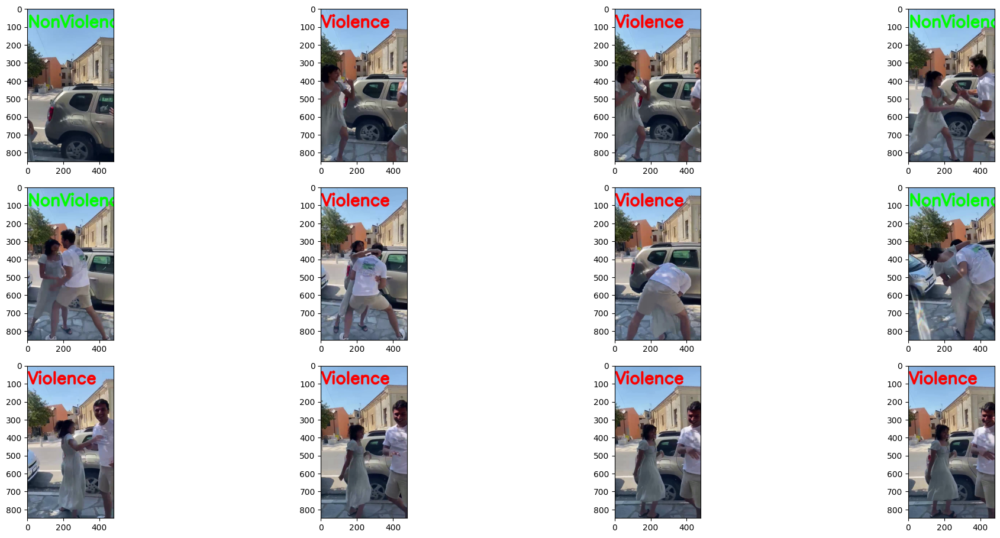

In [ ]:
input_video_file_path = "../content/drive/MyDrive/Real Life Violence Dataset/Violence/V_01.mp4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Show random frames from the output video
show_pred_frames(output_video_file_path)

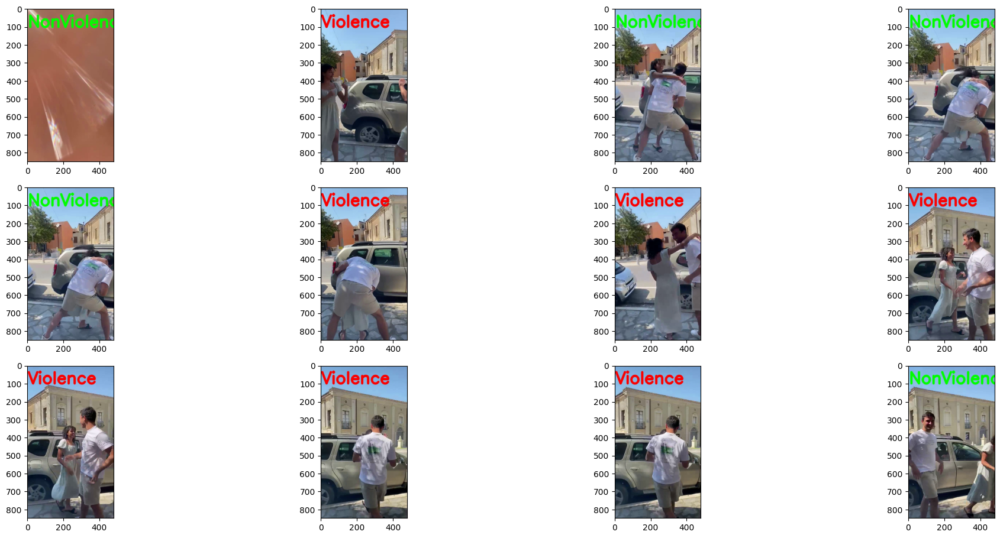

In [ ]:
# Specifying video to be predicted
input_video_file_path = "../content/drive/MyDrive/ Life Violence Dataset/NonViolence/NV_01.mp4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Show random frames from the output video
show_pred_frames(output_video_file_path)

In [ ]:
def predict_video(video_file_path, SEQUENCE_LENGTH):

    video_reader = cv2.VideoCapture(video_file_path)

    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Declare a list to store video frames we will extract.
    frames_list = []

    # Store the predicted class in the video.
    predicted_class_name = ''

     # Get the number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))

    # Calculate the interval after which frames will be added to the list.
    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH),1)

    # Iterating the number of times equal to the fixed length of sequence.
    for frame_counter in range(SEQUENCE_LENGTH):

        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)

        success, frame = video_reader.read()

        if not success:
            break

        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))

        # Normalize the resized frame.
        normalized_frame = resized_frame / 255

        # Appending the pre-processed frame into the frames list
        frames_list.append(normalized_frame)


    # Passing the  pre-processed frames to the model and get the predicted probabilities.
    predicted_labels_probabilities = MoBiLSTM_model.predict(np.expand_dims(frames_list, axis = 0))[0]

    # Get the index of class with highest probability.
    predicted_label = np.argmax(predicted_labels_probabilities)

    # Get the class name using the retrieved index.
    predicted_class_name = CLASSES_LIST[predicted_label]

    # Display the predicted class along with the prediction confidence.
    print(f'Predicted: {predicted_class_name}\nConfidence: {predicted_labels_probabilities[predicted_label]}')

    video_reader.release()

In [ ]:
input_video_file_path = "../content/drive/MyDrive/Real Life Violence Dataset/Violence/V_10.mp4"

# Perform Single Prediction on the Test Video.
predict_video(input_video_file_path, SEQUENCE_LENGTH)

# Play the actual video
Play_Video(input_video_file_path)

1/1 [==============================] - 0s 28ms/step
Predicted: Violence
Confidence: 0.8682140707969666


In [ ]:
input_video_file_path = "../content/drive/MyDrive/Real Life Violence Dataset/NonViolence/NV_23.mp4"

# Perform Single Prediction on the Test Video.
predict_video(input_video_file_path, SEQUENCE_LENGTH)

# Play the actual video
Play_Video(input_video_file_path)

1/1 [==============================] - 0s 31ms/step
Predicted: NonViolence
Confidence: 0.9928736686706543


In [ ]:
MoBiLSTM_model.save('violence.h5')

In [ ]:
Play_Video(f"{non_violence_path}/{Rand_NonViolence_Video}")

In [ ]:
Play_Video(f"{violence_path}/{Rand_Violence_Video}")

In [ ]:
#Play_Video('/website/working/test_videos/Output-Test-Video.mp4')